In [1]:
import pandas as pd

In [2]:
train_df = (pd.read_csv("../input/train.csv")
           )

In [3]:
train_df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Prediction,Time,Summary,Text
0,492346,B001VNP0Y6,AEZRVY3CV52UZ,"Corey Wright ""Democratus""",3,3,5,1320537600,Just what I needed,I got them in a very timely manner and they're...
1,343811,B008J1HO4C,A18VZYSLOUO060,"D. Simpson ""Frugal SOB""",2,2,5,1204329600,Most excellent oatmeal,McCann's Steel Cut Oatmeal is the perfect brea...
2,347257,B000FFIL60,A28Y1M7GRG0I9M,"Real Comments ""Lin""",0,0,4,1318464000,Quality Tea,I would recommend it. Quality pearls and a few...
3,225529,B002ZX1U9A,A245HC4T5J97WG,Logan DeAngelis,0,0,5,1306540800,Great Coffee at a Great price,"I have to admit, I first purchased these Hazel..."
4,485488,B001RVFERK,AVABPJCKE2MR5,spal,0,0,4,1314921600,Popchips Jalapeno flavor,I bought a case of jalapeno chips as I love th...


In [3]:
train_sampled = train_df.sample(n=int(train_df.shape[0] / 1000))

In [5]:
from altair import Chart, X, Y

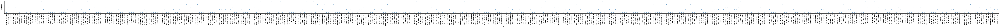

In [6]:
Chart(train_sampled).mark_point().encode(
    x='UserId',
    y='Prediction:O'
)

In [7]:
train_df.UserId.describe()

count             454760
unique            219806
top       A3OXHLG6DIBRW8
freq                 345
Name: UserId, dtype: object

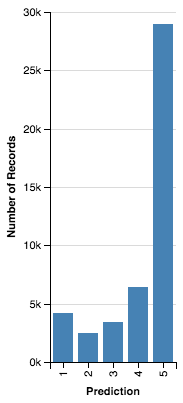

In [8]:
Chart(train_df.sample(n=int(train_df.shape[0] / 10))).mark_bar().encode(
    x='Prediction:O',
    y=Y('count(*):Q')
)

In [9]:
train_df.ProductId.describe()

count         454760
unique         67726
top       B007JFMH8M
freq             714
Name: ProductId, dtype: object

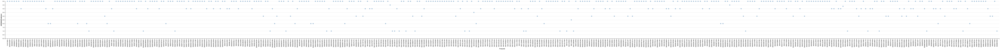

In [10]:
Chart(train_sampled).mark_point().encode(
    x='ProductId',
    y=Y('average(Prediction)')
)

In [4]:
test_df = pd.read_csv("../input/test.csv")

In [12]:
print("Unique users in train: {}\nUnique users in test: {}\nUnique users in train and in test: {}".format(len(set(train_df.UserId)), len(set(test_df.UserId)), len(set(train_df.UserId).intersection(set(test_df.UserId)))))

Unique users in train: 219806
Unique users in test: 78985
Unique users in train and in test: 42734


In [13]:
print("Unique users in train and in test: {}".format(len(set(train_df.ProductId).intersection(set(test_df.ProductId)))))

Unique users in train and in test: 27297


In [4]:
import sys
sys.path.append("../src")
from recsys import RecSys

/Users/dpetrov/.anaconda/lib/python3.5/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn('LightFM was compiled without OpenMP support. '


In [5]:
rs = RecSys("UserId", "ProductId", "Prediction")

In [6]:
%time rs.fit(train_sampled)

ValueError: ndarray is not C-contiguous

In [7]:
test_sampled = train_df.sample(n=int(train_df.shape[0] / 5000))
pred = rs.predict(test_sampled.UserId.values, test_sampled.ProductId.values)

In [8]:
pred

array([-0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00188104,
       -0.00188104, -0.00188104, -0.00188104, -0.00188104, -0.00

In [9]:
test_sampled.Prediction.values

array([5, 4, 3, 1, 5, 1, 2, 5, 5, 5, 5, 5, 3, 5, 5, 4, 5, 5, 5, 3, 2, 4, 5,
       2, 2, 5, 5, 5, 4, 3, 4, 5, 5, 5, 4, 5, 5, 5, 4, 5, 4, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 4, 1, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 1, 5, 5, 5, 5, 2, 3,
       5, 5, 5, 5, 1, 5, 4, 5, 4, 5, 1, 5, 5, 5, 5, 5, 5, 5, 4, 5, 4])

In [9]:
rs._RecSys__df_to_sparsematrix(train_sampled)

<451x432 sparse matrix of type '<class 'numpy.int32'>'
	with 454 stored elements in COOrdinate format>

In [7]:
rs._RecSys__users

{'A1RWPU0K5GOV2C': 3383,
 'A33XL3E3XH2VW4': 1030,
 'A1PMWV2ONVKY75': 638,
 'AHBAKW0KDYBCG': 982,
 'A166Q5SN8CP8UU': 1626,
 'A31D5HQ8EQZ293': 319,
 'A120EP5BKAUB5N': 3236,
 'A35V15GHSS25PP': 3806,
 'APEVX10M5XJPB': 146,
 'ATI8X8CPAU5N6': 4336,
 'AIPAQAZVOOIFC': 729,
 'A1UIN5MWKRMUTG': 3765,
 'A113VPNWA64OZ2': 4172,
 'A1AU9JUUYE2BDM': 3398,
 'A1CRH5SAVS1Q5E': 1796,
 'A2E5E5SS7BWK6P': 2995,
 'A3NXCL9NJTL3TF': 2528,
 'A1VWTXIXVMHR7Q': 39,
 'A125EA9YX1FQ62': 1965,
 'A6Y2WVJNHZBSJ': 1073,
 'A1KJDOL79GJ3JI': 2377,
 'A17VCE29NLF4W3': 3022,
 'A1L7AFJNYLTQEY': 3551,
 'A180U294SG121U': 4259,
 'A3NWN21HH5CEWZ': 3018,
 'A25SAHFBY6AYAP': 584,
 'A39E104T0KIDLX': 3787,
 'A28NEA0ZJGJNKK': 3322,
 'A1X0RCHX5QNPUK': 1278,
 'ABLII5SS5RXH8': 2227,
 'A1ZSF5CJ0A4CIO': 411,
 'A27O836I8PNATA': 452,
 'A7SK7TU79ZXE5': 887,
 'A3KWCSLQJ479JS': 3925,
 'A3Q5A3ZY0EO4P3': 757,
 'A11TZXDH7Q4GX1': 3003,
 'A3S3L24L3MMDXR': 592,
 'A21BYJN4O600W3': 626,
 'A12XR04PX9W884': 3731,
 'A264UDLWWRJ7X4': 3954,
 'A7FJTKSOP7BAU': 249